In [1]:
import warnings
warnings.filterwarnings('ignore')

## Imports

In [2]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

import cv2
from skimage import io

In [3]:
from typing import Union

from collections import defaultdict
from itertools import combinations

from skimage.transform import rescale
from skimage.measure import label, find_contours
from skimage.filters import gaussian
from skimage.feature import match_template
from scipy.ndimage import convolve
from scipy.spatial.distance import cdist
import scipy.stats as st

In [18]:
import evaluate

In [6]:
def plot_img(img, cmap='gray', figsize=(12,6)):
    plt.figure(figsize=figsize)
    plt.imshow(img, cmap=cmap)
    #plt.axis('off')
    plt.show()

In [7]:
evaluate.main()

### train case `all` ###
Score = 7.65
Prediction time = 17.40s. Evaluation overhead = 0.13s.

### train case `black_blue_green` ###
Score = 7.50
Prediction time = 20.75s. Evaluation overhead = 0.24s.

### train case `black_red_yellow` ###
Score = 7.15
Prediction time = 23.99s. Evaluation overhead = 0.19s.

### train case `red_green_blue_inaccurate` ###
Score = 8.99
Prediction time = 22.03s. Evaluation overhead = 0.26s.

### train case `red_green_blue` ###
Score = 8.95
Prediction time = 14.84s. Evaluation overhead = 0.20s.

### Summary ###
Final train score = 40.24 out of 50.00
Total evaluation time = 100.02s for 5 images.
The platform limit is 2400s for 10 images.


## Loading image

In [7]:
IMG = 'black_blue_green'

In [8]:
img_all = np.float32(cv2.imread(f'train/all.jpg', 0))
img_bry = np.float32(cv2.imread(f'train/black_red_yellow.jpg', 0))

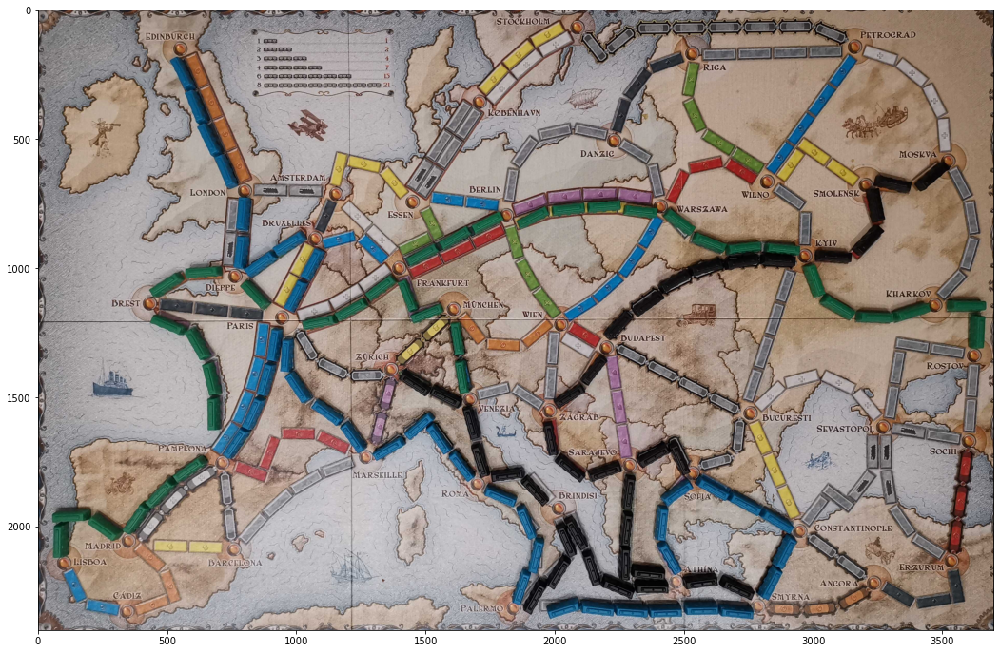

In [9]:
img_orig = io.imread(f'train/{IMG}.jpg')[100:-100, 100:-100]
img = np.float32(cv2.imread(f'train/{IMG}.jpg', 0))[100:-100, 100:-100]

plot_img(img_orig, figsize=(24,12))

## Choosing template

In [21]:
template = img_all[796:834,1506:1544]
#template = img[1:36,574:609]  # more backgound = better; why? = interesting question to think about

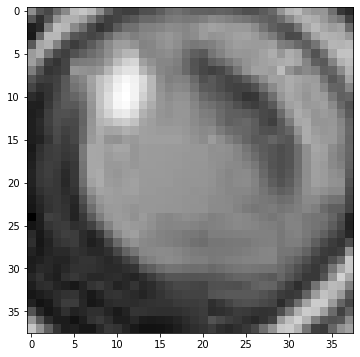

In [22]:
plot_img(template)

## Normalized convolution

https://www.researchgate.net/publication/2378357_Fast_Normalized_Cross-Correlation

In [23]:
corr_skimage = match_template(img, template, pad_input=True)

In [ ]:
plot_img(corr_skimage)

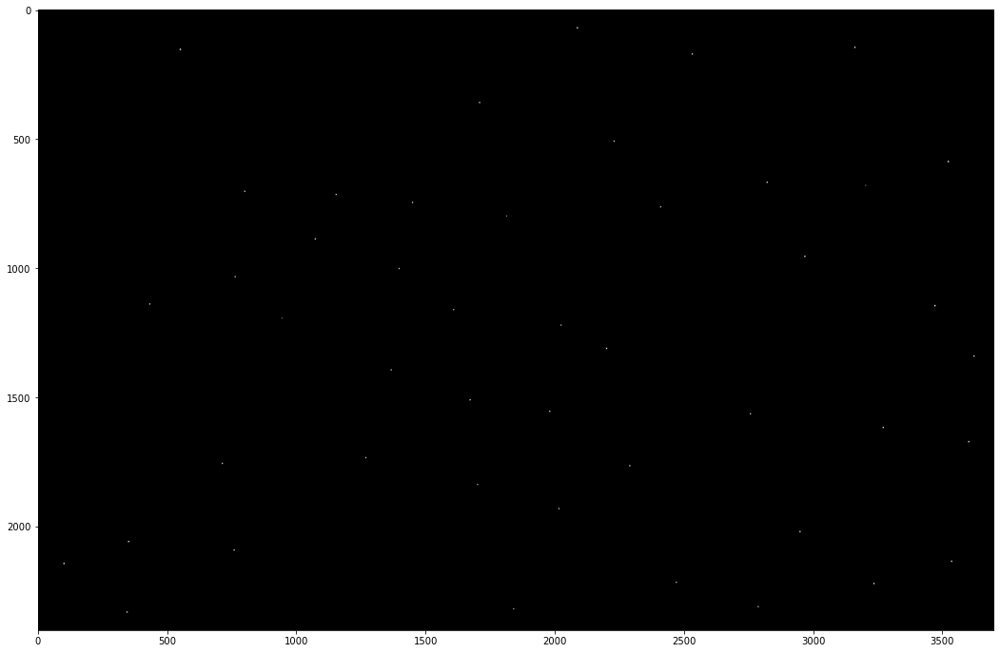

In [24]:
plot_img(corr_skimage > 0.7, figsize=(24,12))

## Finding oblects: thresholding and local maximum

In [25]:
# maximum -> center of mass
def get_local_centers(corr, th):
    lbl, n = label(corr >= th, connectivity=2, return_num=True)
    return np.int16([np.round(np.mean(np.argwhere(lbl == i), axis=0)) for i in range(1, n + 1)])


def plot_rectangles(img, points, bbox_shape):
    points = np.int16(points)[::, ::-1]
    res_img = np.int16(img.copy())
    for pt in points:
        cv2.rectangle(res_img, (pt[0] - bbox_shape[0] // 2, pt[1] - bbox_shape[1] // 2),
                      (pt[0] + bbox_shape[0] // 2, pt[1] + bbox_shape[1] // 2), (255, 255, 255), 5)
    return res_img

def plot_circles(img, points, radius=30, color=(255,255,255)):
    points = np.int16(points)[::, ::-1]
    res_img = np.int16(img.copy())
    for pt in points:
        cv2.circle(res_img, (pt[0], pt[1]), radius, color, -5)
    return res_img

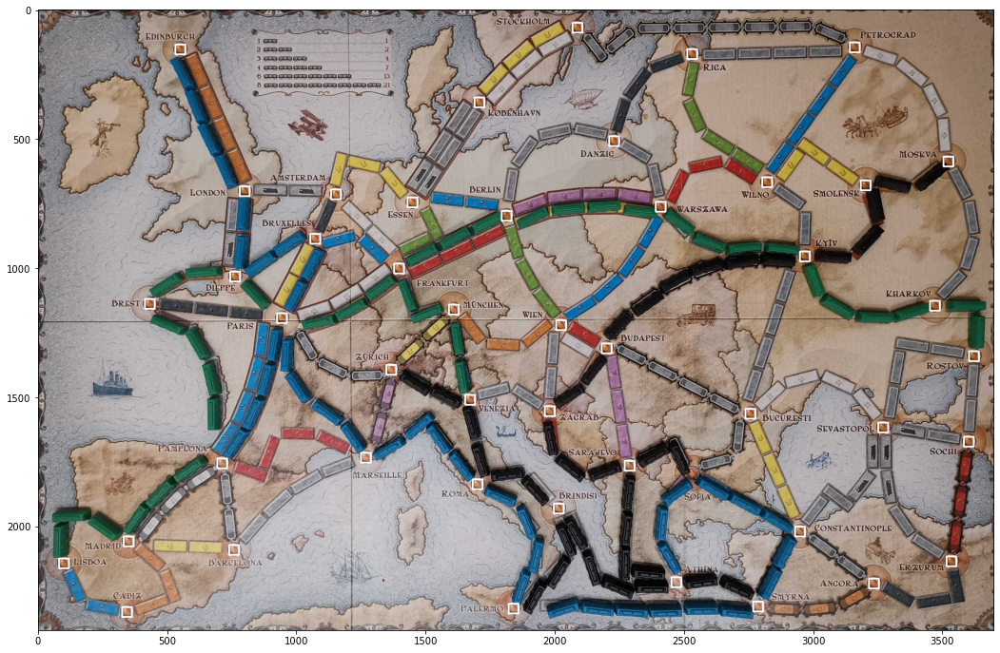

In [26]:
points = get_local_centers(corr_skimage, 0.7)
res = plot_rectangles(img_orig, points, template.shape)

plot_img(res, cmap=None, figsize=(24,12))

## Convert colors to HLS space

In [10]:
img_cv = cv2.imread(f'train/{IMG}.jpg')[..., ::-1]

In [12]:
from ticket_to_ride import predict_image

In [13]:
_, trains, scores = predict_image(img_cv[..., ::-1])

In [14]:
trains

{'blue': 200, 'green': 200, 'black': 200, 'yellow': 200, 'red': 200}

In [15]:
scores

{'blue': 0, 'green': 38, 'black': 62.0, 'yellow': 0, 'red': 0}

In [19]:
gt_centers = evaluate.load_json(f'train/{IMG}_centers.json')
gt_n_trains = evaluate.load_json(f'train/{IMG}_n_trains.json')
gt_scores = evaluate.load_json(f'train/{IMG}_scores.json')

In [20]:
gt_n_trains

{'blue': 40, 'green': 37, 'black': 37, 'yellow': 0, 'red': 0}

In [21]:
gt_scores

{'blue': 66, 'green': 53, 'black': 55, 'yellow': 0, 'red': 0}

In [30]:
#img_cv = cv2.GaussianBlur(img_cv, (21,21), cv2.BORDER_DEFAULT)

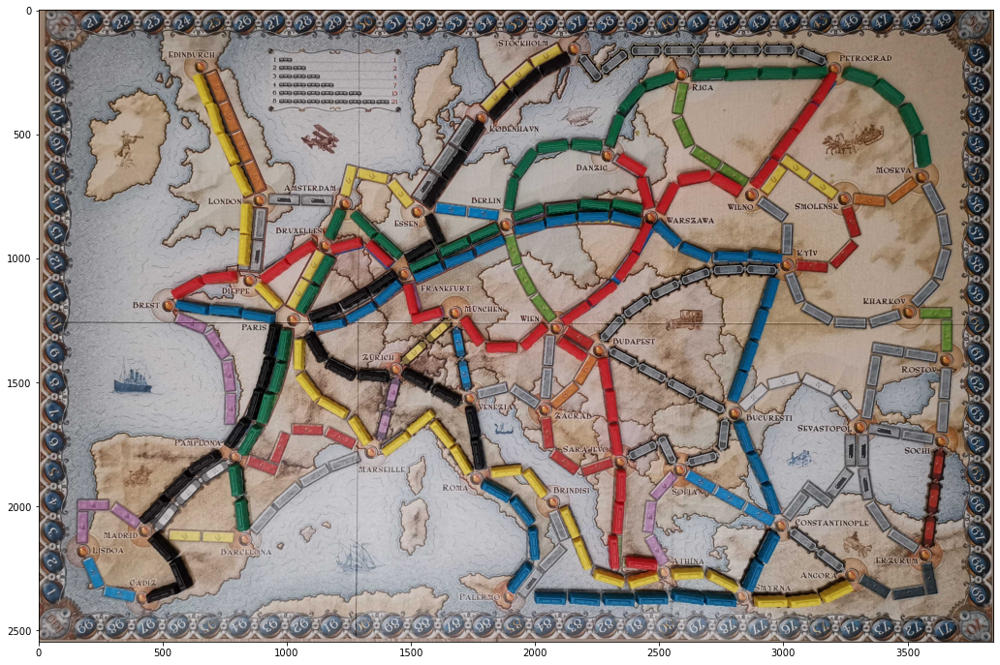

In [31]:
plt.figure(figsize=(24, 12))
plt.imshow(img_cv)

In [33]:
template_r = img_all[1680:1707,1068:1095]

In [39]:
corr_skimage = match_template(img, template_r, pad_input=True)

In [40]:
points1 = get_local_centers(corr_skimage, 0.5)
res = plot_circles(img_orig, points1)

In [41]:
template_b = img_all[792:820,1647:1672]

In [42]:
corr_skimage = match_template(img, template_b, pad_input=True)

In [43]:
points2 = get_local_centers(corr_skimage, 0.5)
res = plot_circles(res, points2)

In [44]:
template_y = img_all[655:685,1330:1355]

In [45]:
corr_skimage = match_template(img, template_y, pad_input=True)

In [46]:
points3 = get_local_centers(corr_skimage, 0.5)
res = plot_circles(res, points3)

In [47]:
template_k = img_bry[1765:1790, 1775:1800]

In [48]:
corr_skimage = match_template(img, template_k, pad_input=True)

In [49]:
points4 = get_local_centers(corr_skimage, 0.5)
res = plot_circles(res, points4)

In [50]:
res = res.astype('uint8')

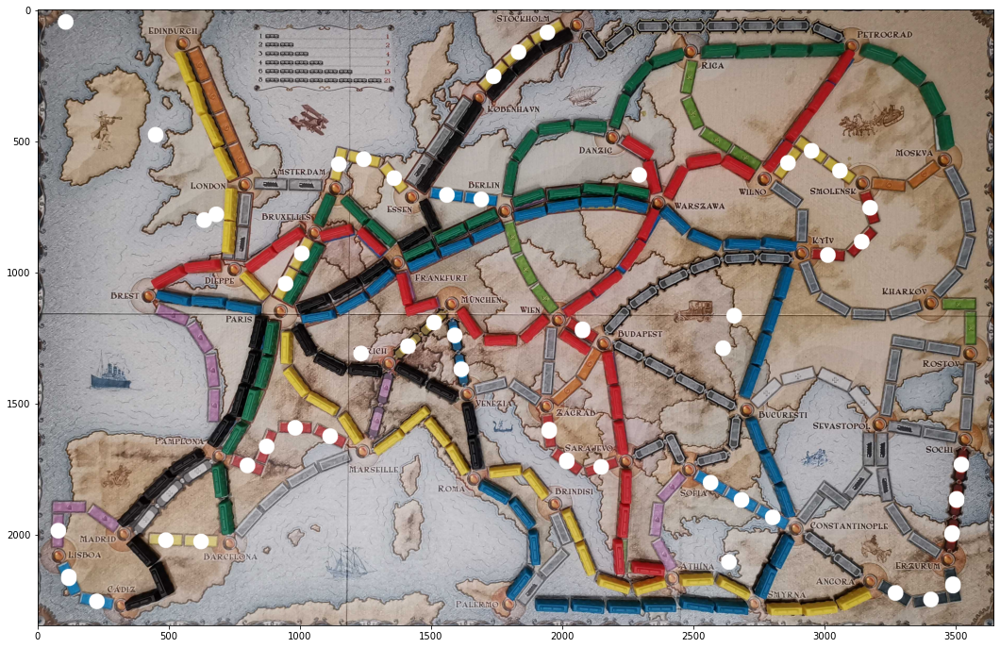

In [51]:
plot_img(res, cmap=None, figsize=(24,12))

In [52]:
HLS = cv2.cvtColor(res, cv2.COLOR_RGB2HLS)

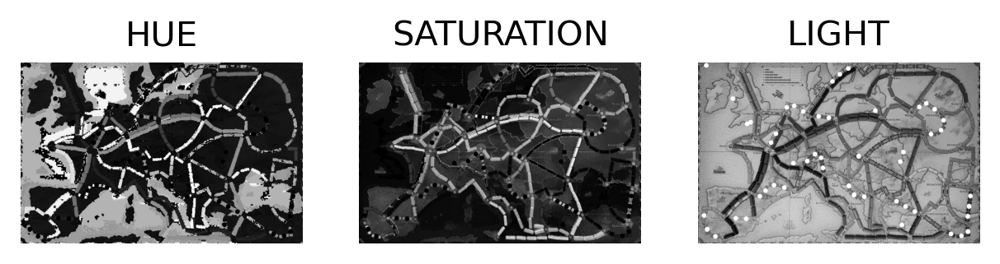

In [53]:
HUE = HLS[:, :, 0]              # Split attributes
LIGHT = HLS[:, :, 1]
SAT = HLS[:, :, 2]

plt.figure(dpi=250)
plt.subplot(1,3,1)              # Plot color attributes
plt.imshow(HUE, cmap='gray')
plt.title('HUE')
plt.axis('off')
plt.subplot(1,3,2)
plt.imshow(SAT, cmap='gray')
plt.title('SATURATION')
plt.axis('off')
plt.subplot(1,3,3)
plt.imshow(LIGHT, cmap='gray')
plt.title('LIGHT')
plt.axis('off')
plt.show()

### RED

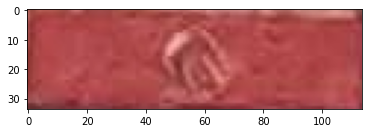

In [54]:
plot_img(img_cv[1676:1710, 1026:1140], figsize=(6,3))

In [44]:
np.unique(HUE[1676:1710, 1026:1140])

array([  0,   1,   2,   3,   4, 175, 176, 177, 178, 179, 180], dtype=uint8)

In [45]:
np.unique(LIGHT[1676:1710, 1026:1140])

array([ 72,  74,  77,  79,  80,  82,  83,  84,  86,  87,  88,  90,  91,
        92,  93,  94,  95,  96,  97,  98,  99, 100, 101, 102, 103, 104,
       105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117,
       118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130,
       131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143,
       144, 145, 146, 147, 148, 150, 152, 153, 155, 157, 158, 159, 160,
       161, 162, 163, 164, 166, 167, 168, 170, 171, 173, 174, 175, 176,
       178, 179, 180, 182, 183, 255], dtype=uint8)

In [46]:
np.unique(SAT[1676:1710, 1026:1140])

array([  0,  68,  70,  71,  73,  76,  77,  78,  79,  80,  81,  82,  83,
        84,  85,  86,  87,  88,  89,  90,  91,  92,  93,  94,  95,  96,
        97,  98,  99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109,
       110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122,
       123, 124, 125, 126, 127, 128, 129, 131, 132, 134, 135, 136, 137,
       139, 141, 145], dtype=uint8)

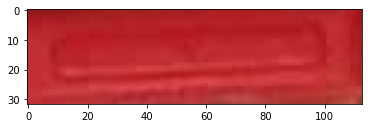

In [66]:
plot_img(img_cv[1346:1378, 1810:1923], figsize=(6,3))

In [67]:
np.unique(HUE[1346:1378, 1810:1923])

array([  0,   1,   2,   3,   4, 178, 179, 180], dtype=uint8)

In [68]:
np.unique(LIGHT[1346:1378, 1810:1923])

array([ 84,  85,  86,  87,  88,  89,  90,  91,  92,  93,  94,  95,  96,
        97,  98,  99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109,
       110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122,
       123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135,
       136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148,
       149, 150], dtype=uint8)

In [69]:
np.unique(SAT[1346:1378, 1810:1923])

array([110, 111, 112, 113, 114, 115, 116, 118, 119, 120, 121, 122, 123,
       124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136,
       137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149,
       150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162,
       163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175,
       176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188,
       189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 202],
      dtype=uint8)

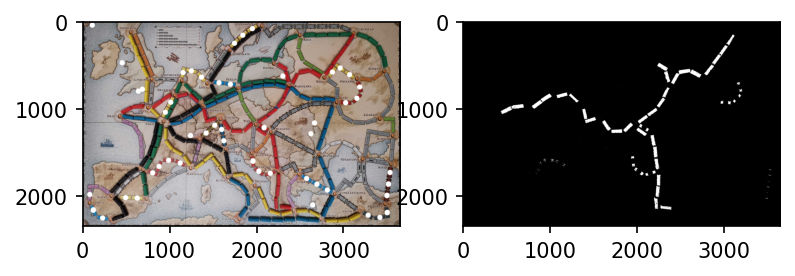

In [55]:
mask = ((HUE < 5) | (HUE > 177)) & (LIGHT > 80) & (LIGHT < 150) & (SAT > 110) & (SAT < 205)
img2 = res.copy()
# img2[mask] = 0

plt.figure(dpi=150)
plt.subplot(1,2,1)   
# plt.axis('off')
plt.imshow(img2)
plt.subplot(1,2,2)     
# plt.axis('off')
plt.imshow(mask, cmap="gray")

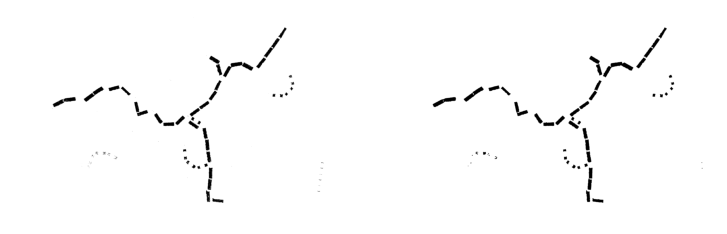

In [56]:
mask_int = mask.astype(np.uint8)
kernel = np.ones((7,7))
mask_int = cv2.morphologyEx(mask_int, cv2.MORPH_CLOSE, kernel)
kernel = np.ones((5,5))
mask_int = cv2.morphologyEx(mask_int, cv2.MORPH_OPEN, kernel)


plt.figure(dpi=150)
plt.subplot(1,2,1)   
plt.axis('off')
plt.imshow(1 - mask, cmap="gray")
plt.subplot(1,2,2)  
plt.axis('off')
plt.imshow(1 - mask_int, cmap="gray")

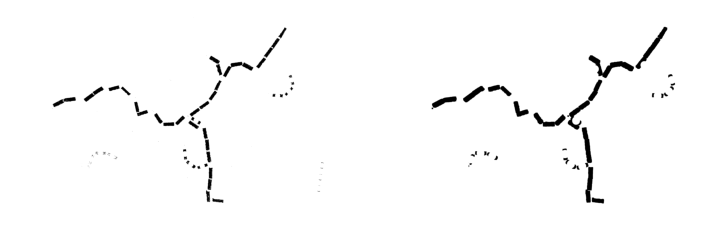

In [57]:
mask_int = mask.astype(np.uint8)
kernel = np.ones((9,9))
mask_int = cv2.morphologyEx(mask_int, cv2.MORPH_DILATE, kernel)
kernel = np.ones((11,11))
mask_int = cv2.morphologyEx(mask_int, cv2.MORPH_ERODE, kernel)
kernel = np.ones((17,17))
mask_int = cv2.morphologyEx(mask_int, cv2.MORPH_DILATE, kernel)
mask_int = plot_circles(mask_int, points1, 45, color=0)
mask_int = plot_circles(mask_int, points2, 45, color=0)
mask_int = plot_circles(mask_int, points3, 45, color=0)
mask_int = plot_circles(mask_int, points4, 45, color=0)
mask_int = mask_int.astype(np.uint8)


plt.figure(dpi=150)
plt.subplot(1,2,1)   
plt.axis('off')
plt.imshow(1 - mask, cmap="gray")
plt.subplot(1,2,2)  
plt.axis('off')
plt.imshow(1 - mask_int, cmap="gray")

In [58]:
contours, hierarchy = cv2.findContours(mask_int, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)

img_cnt = img_cv[100:-100, 100:-100].copy()
cv2.drawContours(img_cnt, contours, -1, (255,0,0), 10);

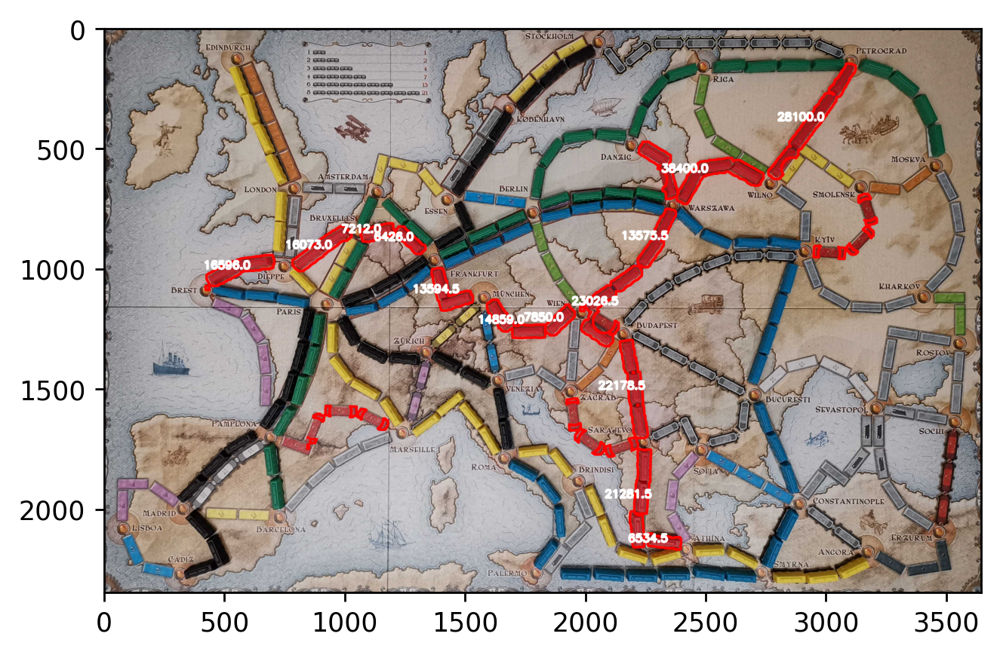

In [59]:
for i in range(len(contours)):
    area = cv2.contourArea(contours[i])
    if area < 5000:
        continue
    string = f'{area}'
    M = cv2.moments(contours[i])
    cX = int((M["m10"] / M["m00"]))
    cY = int((M["m01"] / M["m00"]))
    if np.isclose(area, 9028.5):
        cv2.putText(img_cnt, string, (cX-150, cY), cv2.FONT_HERSHEY_SIMPLEX, 3, (255, 255, 255), 10)
    else:
        cv2.putText(img_cnt, string, (cX-150, cY), cv2.FONT_HERSHEY_SIMPLEX, 1.5, (255, 255, 255), 10)
    
plt.figure(dpi=250)    
plt.imshow(img_cnt)

### BLUE

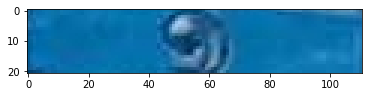

In [93]:
plot_img(img_cv[794:815, 1604:1715], figsize=(6,3))

In [94]:
np.unique(HUE[794:815, 1604:1715])

array([  0,  99, 100, 101, 102, 103], dtype=uint8)

In [95]:
np.unique(LIGHT[794:815, 1604:1715])

array([ 52,  55,  62,  66,  68,  70,  71,  72,  73,  74,  75,  76,  77,
        78,  79,  80,  81,  82,  83,  84,  85,  86,  87,  88,  89,  90,
        91,  92,  93,  94,  95,  96,  97,  98,  99, 100, 101, 102, 103,
       104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 115, 116, 117,
       118, 119, 120, 121, 122, 123, 124, 127, 128, 132, 134, 144, 255],
      dtype=uint8)

In [96]:
np.unique(SAT[794:815, 1604:1715])

array([  0,  96,  99, 101, 102, 104, 105, 109, 110, 116, 119, 120, 121,
       123, 124, 126, 130, 131, 132, 135, 136, 137, 140, 142, 145, 149,
       150, 151, 152, 153, 158, 159, 161, 162, 163, 166, 168, 170, 171,
       172, 173, 174, 175, 177, 178, 179, 180, 181, 182, 183, 184, 185,
       186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198,
       199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211,
       212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224,
       225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 236, 237,
       238, 239, 240, 241, 242, 243, 244, 245, 246, 249, 250, 252, 255],
      dtype=uint8)

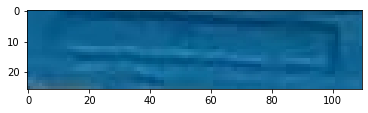

In [107]:
plot_img(img_cv[1200:1226, 690:800], figsize=(6,3))

In [108]:
np.unique(HUE[1200:1226, 690:800])

array([ 98,  99, 100, 101, 102, 103, 104], dtype=uint8)

In [109]:
np.unique(LIGHT[1200:1226, 690:800])

array([ 51,  52,  53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,
        64,  65,  66,  67,  68,  69,  70,  71,  72,  73,  74,  75,  76,
        77,  78,  79,  80,  81,  82,  83,  84,  85,  86,  87,  88,  89,
        90,  91,  92,  93,  94,  95,  96,  97,  98,  99, 100, 101, 102,
       103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114],
      dtype=uint8)

In [110]:
np.unique(SAT[1200:1226, 690:800])

array([ 82,  83,  87,  88,  89,  92,  93,  94,  96,  97, 101, 108, 109,
       113, 116, 117, 121, 122, 124, 125, 126, 128, 129, 130, 132, 133,
       135, 136, 137, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148,
       149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161,
       162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174,
       175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187,
       188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200,
       201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213,
       214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226,
       227, 228, 229, 230, 231, 232, 233, 234, 235, 236, 237, 238, 239,
       240, 241, 242, 243, 244, 245, 246, 247, 248, 250, 251, 255],
      dtype=uint8)

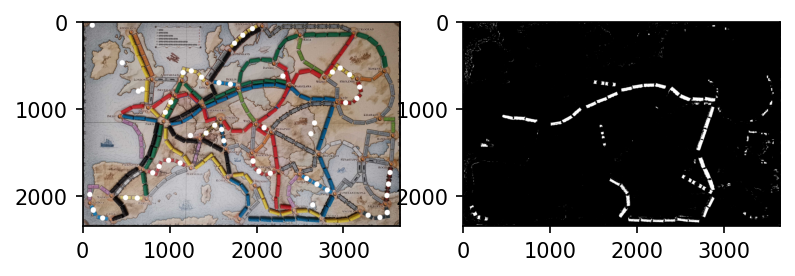

In [60]:
mask = (HUE < 106) & (HUE > 97) & (LIGHT < 115) & (LIGHT > 50)
img2 = res.copy()
# img2[mask] = 0

plt.figure(dpi=150)
plt.subplot(1,2,1)
# plt.axis('off')
plt.imshow(img2)
plt.subplot(1,2,2)     
# plt.axis('off')
plt.imshow(mask, cmap="gray")

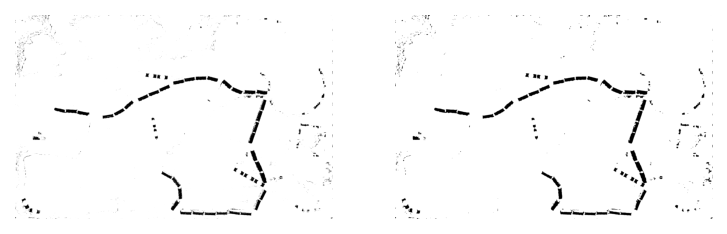

In [61]:
mask_int = mask.astype(np.uint8)
kernel = np.ones((5,5))
mask_int = cv2.morphologyEx(mask_int, cv2.MORPH_CLOSE, kernel)
kernel = np.ones((3,3))
mask_int = cv2.morphologyEx(mask_int, cv2.MORPH_OPEN, kernel)


plt.figure(dpi=150)
plt.subplot(1,2,1)   
plt.axis('off')
plt.imshow(1 - mask, cmap="gray")
plt.subplot(1,2,2)  
plt.axis('off')
plt.imshow(1 - mask_int, cmap="gray")

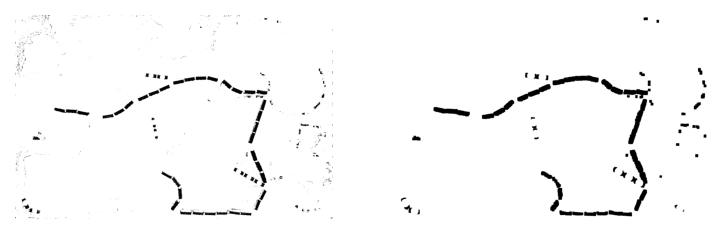

In [66]:
mask_int = mask.astype(np.uint8)
kernel = np.ones((5,5))
mask_int = cv2.morphologyEx(mask_int, cv2.MORPH_ERODE, kernel)
kernel = np.ones((5,5))
mask_int = cv2.morphologyEx(mask_int, cv2.MORPH_DILATE, kernel)
kernel = np.ones((9,9))
mask_int = cv2.morphologyEx(mask_int, cv2.MORPH_ERODE, kernel)
kernel = np.ones((27,27))
mask_int = cv2.morphologyEx(mask_int, cv2.MORPH_DILATE, kernel)
mask_int = plot_circles(mask_int, points1, 45, color=0)
mask_int = plot_circles(mask_int, points2, 45, color=0)
mask_int = plot_circles(mask_int, points3, 45, color=0)
mask_int = plot_circles(mask_int, points4, 45, color=0)
mask_int = mask_int.astype(np.uint8)


plt.figure(dpi=150)
plt.subplot(1,2,1)   
plt.axis('off')
plt.imshow(1 - mask, cmap="gray")
plt.subplot(1,2,2)  
plt.axis('off')
plt.imshow(1 - mask_int, cmap="gray")

In [67]:
contours, hierarchy = cv2.findContours(mask_int, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)

img_cnt = res.copy()
cv2.drawContours(img_cnt, contours, -1, (255,0,0), 10);

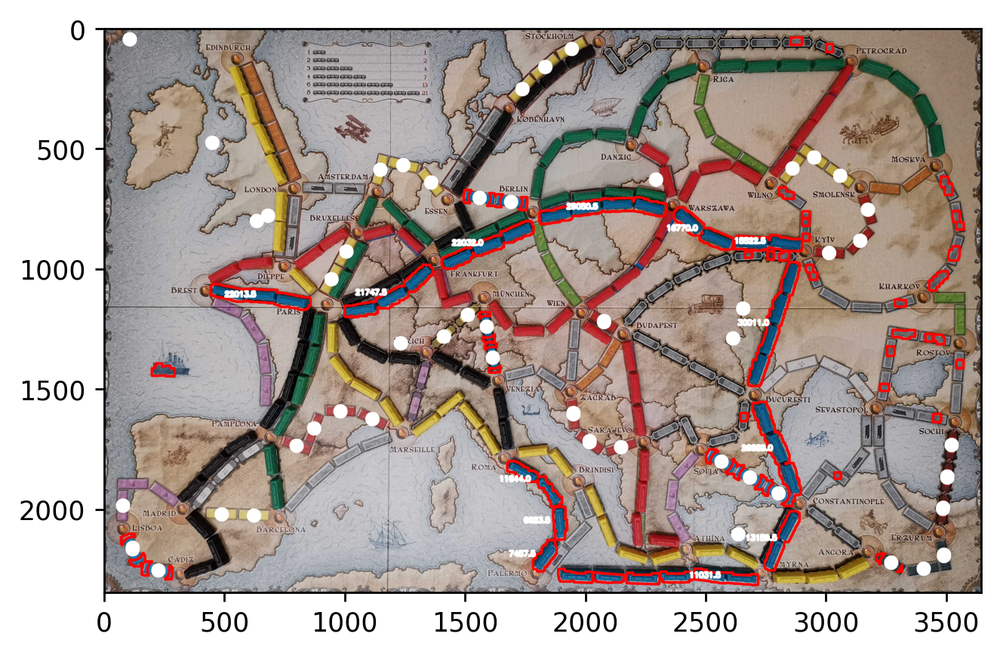

In [68]:
for i in range(len(contours)):
    area = cv2.contourArea(contours[i])
    if area < 6000:
        continue
    string = f'{area}'
    M = cv2.moments(contours[i])
    cX = int((M["m10"] / M["m00"]))
    cY = int((M["m01"] / M["m00"]))
    cv2.putText(img_cnt, string, (cX-150, cY), cv2.FONT_HERSHEY_SIMPLEX, 1, (255, 255, 255), 10)
    
plt.figure(dpi=250)    
plt.imshow(img_cnt)

### GREEN

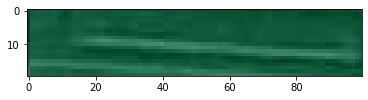

In [359]:
plot_img(img_cv[530:550,2150:2250], figsize=(6,3))

In [360]:
np.unique(HUE[530:550,2150:2250])

array([75, 76, 77, 78, 79, 80], dtype=uint8)

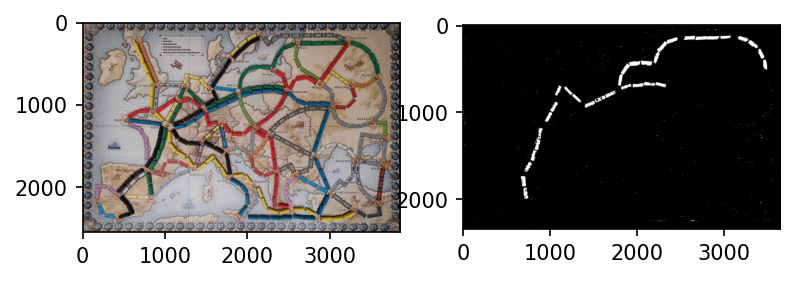

In [61]:
mask = (HUE < 81) & (HUE > 74)# & (LIGHT < 80) & (LIGHT > 50)
img2 = img_cv.copy()
# img2[mask] = 0

plt.figure(dpi=150)
plt.subplot(1,2,1)   
# plt.axis('off')
plt.imshow(img2)
plt.subplot(1,2,2)     
# plt.axis('off')
plt.imshow(mask, cmap="gray")

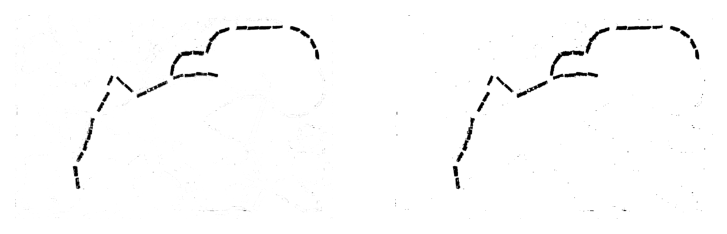

In [62]:
mask_int = mask.astype(np.uint8)
kernel = np.ones((5,5))
mask_int = cv2.morphologyEx(mask_int, cv2.MORPH_CLOSE, kernel)
kernel = np.ones((3,3))
mask_int = cv2.morphologyEx(mask_int, cv2.MORPH_OPEN, kernel)


plt.figure(dpi=150)
plt.subplot(1,2,1)   
plt.axis('off')
plt.imshow(1 - mask, cmap="gray")
plt.subplot(1,2,2)  
plt.axis('off')
plt.imshow(1 - mask_int, cmap="gray")

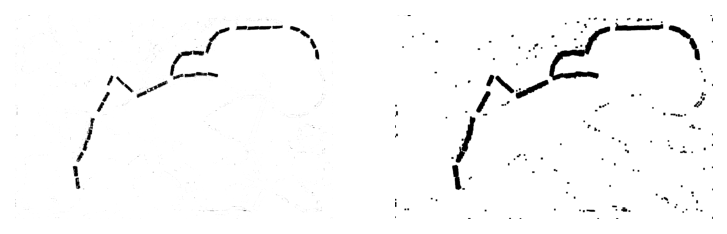

In [353]:
mask_int = mask.astype(np.uint8)
kernel = np.ones((9,9))
mask_int = cv2.morphologyEx(mask_int, cv2.MORPH_DILATE, kernel)
kernel = np.ones((11,11))
mask_int = cv2.morphologyEx(mask_int, cv2.MORPH_ERODE, kernel)
kernel = np.ones((17,17))
mask_int = cv2.morphologyEx(mask_int, cv2.MORPH_DILATE, kernel)


plt.figure(dpi=150)
plt.subplot(1,2,1)   
plt.axis('off')
plt.imshow(1 - mask, cmap="gray")
plt.subplot(1,2,2)  
plt.axis('off')
plt.imshow(1 - mask_int, cmap="gray")

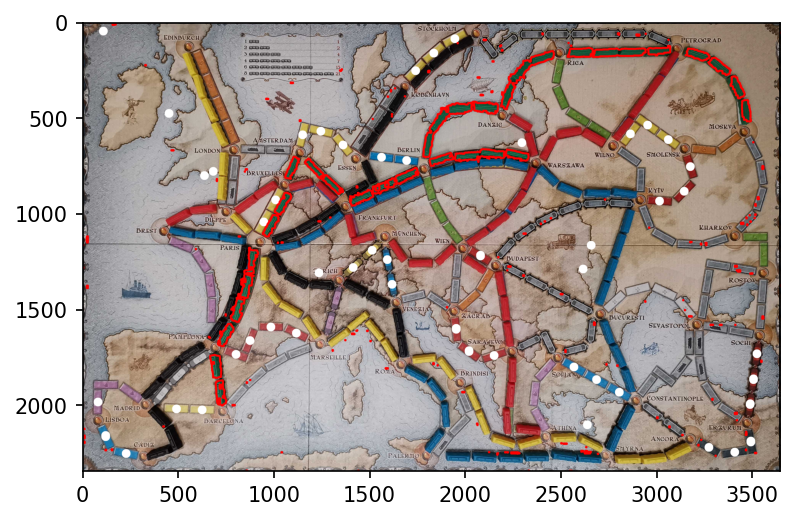

In [63]:
contours, hierarchy = cv2.findContours(mask_int, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)

img_cnt = res.copy()
cv2.drawContours(img_cnt, contours, -1, (255,0,0), 10)
plt.figure(dpi=150)
plt.imshow(img_cnt)

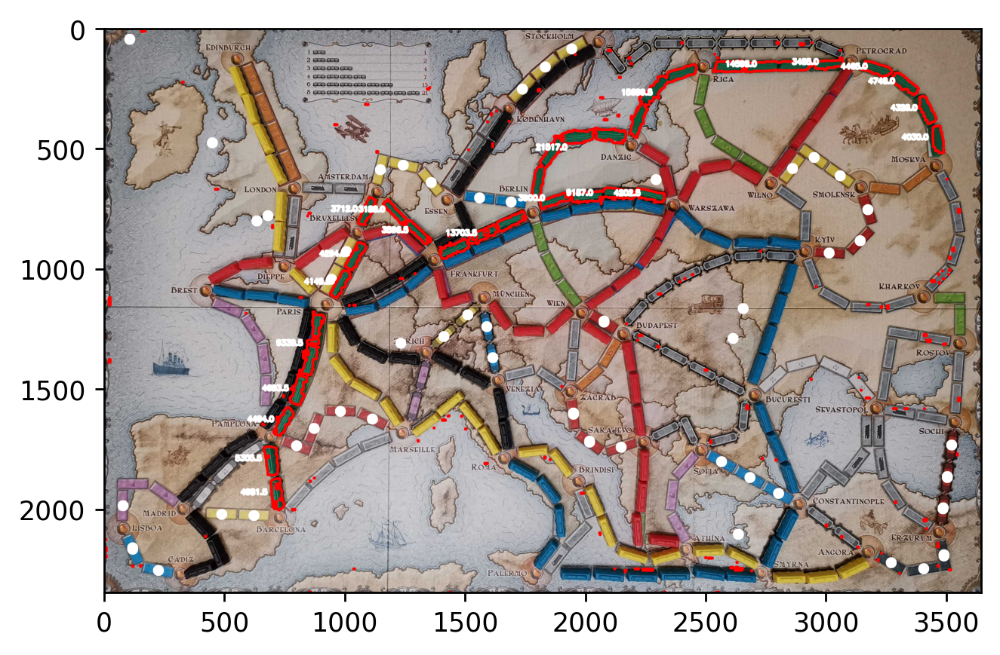

In [64]:
for i in range(len(contours)):
    area = cv2.contourArea(contours[i])
    if area < 2000:
        continue
    string = f'{area}'
    M = cv2.moments(contours[i])
    cX = int((M["m10"] / M["m00"]))
    cY = int((M["m01"] / M["m00"]))
    cv2.putText(img_cnt, string, (cX-150, cY), cv2.FONT_HERSHEY_SIMPLEX, 1, (255, 255, 255), 10)
    
plt.figure(dpi=250)    
plt.imshow(img_cnt)

### YELLOW

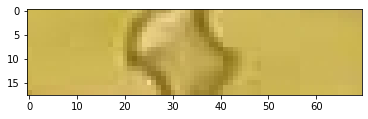

In [245]:
plot_img(img_cv[660:678, 1310:1380], figsize=(6,3))

In [258]:
np.unique(HUE[560:578, 1210:1280])

array([ 0, 22, 23, 24, 25], dtype=uint8)

In [259]:
np.unique(LIGHT[560:578, 1210:1280])

array([128, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150,
       151, 152, 153, 255], dtype=uint8)

In [260]:
np.unique(SAT[560:578, 1210:1280])

array([  0, 118, 121, 122, 124, 125, 126, 127, 128, 129, 130, 131, 132,
       133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145,
       146, 147, 148], dtype=uint8)

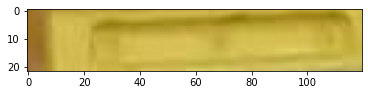

In [256]:
plot_img(img_cv[2270:2292,2550:2670], figsize=(6,3))

In [261]:
np.unique(HUE[2170:2192,2450:2570])

array([15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27], dtype=uint8)

In [262]:
np.unique(LIGHT[2170:2192,2450:2570])

array([ 72,  73,  75,  76,  79,  80,  81,  82,  83,  84,  85,  86,  87,
        88,  89,  90,  91,  92,  93,  94,  95,  96,  97,  98,  99, 100,
       101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113,
       114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126,
       127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139,
       140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152,
       153, 154, 155, 156, 157, 158, 159, 160, 161, 163, 164, 166, 167],
      dtype=uint8)

In [263]:
np.unique(SAT[2170:2192,2450:2570])

array([ 95,  96,  97,  99, 100, 101, 102, 103, 104, 105, 106, 107, 108,
       110, 112, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124,
       125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137,
       138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150,
       151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163,
       164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176,
       177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189,
       190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202,
       203, 206, 208, 211, 214, 216, 224, 225, 234, 237], dtype=uint8)

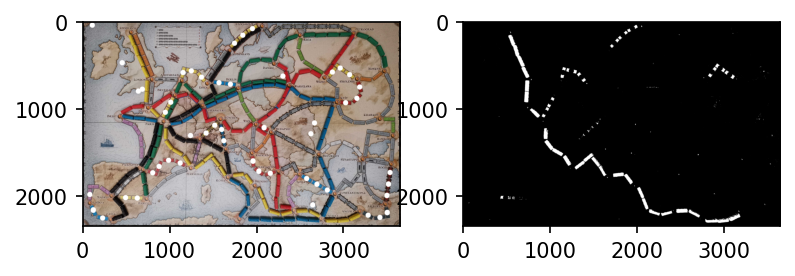

In [69]:
mask = (HUE < 28) & (HUE > 15) & (LIGHT > 70) & (LIGHT < 170) & (SAT > 95)
img2 = res.copy()
# img2[mask] = 0

plt.figure(dpi=150)
plt.subplot(1,2,1)   
# plt.axis('off')
plt.imshow(img2)
plt.subplot(1,2,2)     
# plt.axis('off')
plt.imshow(mask, cmap="gray")

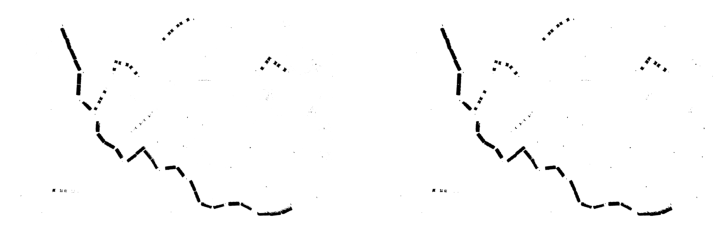

In [70]:
mask_int = mask.astype(np.uint8)
kernel = np.ones((5,5))
mask_int = cv2.morphologyEx(mask_int, cv2.MORPH_CLOSE, kernel)
kernel = np.ones((3,3))
mask_int = cv2.morphologyEx(mask_int, cv2.MORPH_OPEN, kernel)


plt.figure(dpi=150)
plt.subplot(1,2,1)   
plt.axis('off')
plt.imshow(1 - mask, cmap="gray")
plt.subplot(1,2,2)  
plt.axis('off')
plt.imshow(1 - mask_int, cmap="gray")

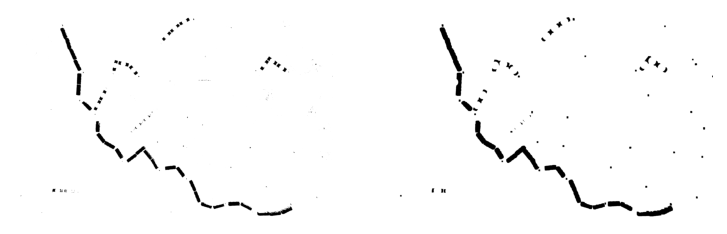

In [71]:
mask_int = mask.astype(np.uint8)
kernel = np.ones((7,7))
mask_int = cv2.morphologyEx(mask_int, cv2.MORPH_DILATE, kernel)
kernel = np.ones((11,11))
mask_int = cv2.morphologyEx(mask_int, cv2.MORPH_ERODE, kernel)
kernel = np.ones((17,17))
mask_int = cv2.morphologyEx(mask_int, cv2.MORPH_DILATE, kernel)
mask_int = plot_circles(mask_int, points1, 45, color=0)
mask_int = plot_circles(mask_int, points2, 45, color=0)
mask_int = plot_circles(mask_int, points3, 45, color=0)
mask_int = plot_circles(mask_int, points4, 45, color=0)
mask_int = mask_int.astype(np.uint8)

plt.figure(dpi=150)
plt.subplot(1,2,1)   
plt.axis('off')
plt.imshow(1 - mask, cmap="gray")
plt.subplot(1,2,2)  
plt.axis('off')
plt.imshow(1 - mask_int, cmap="gray")

In [74]:
contours, hierarchy = cv2.findContours(mask_int, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)

img_cnt = img_cv[100:-100, 100:-100].copy()
cv2.drawContours(img_cnt, contours, -1, (255,0,0), 10);

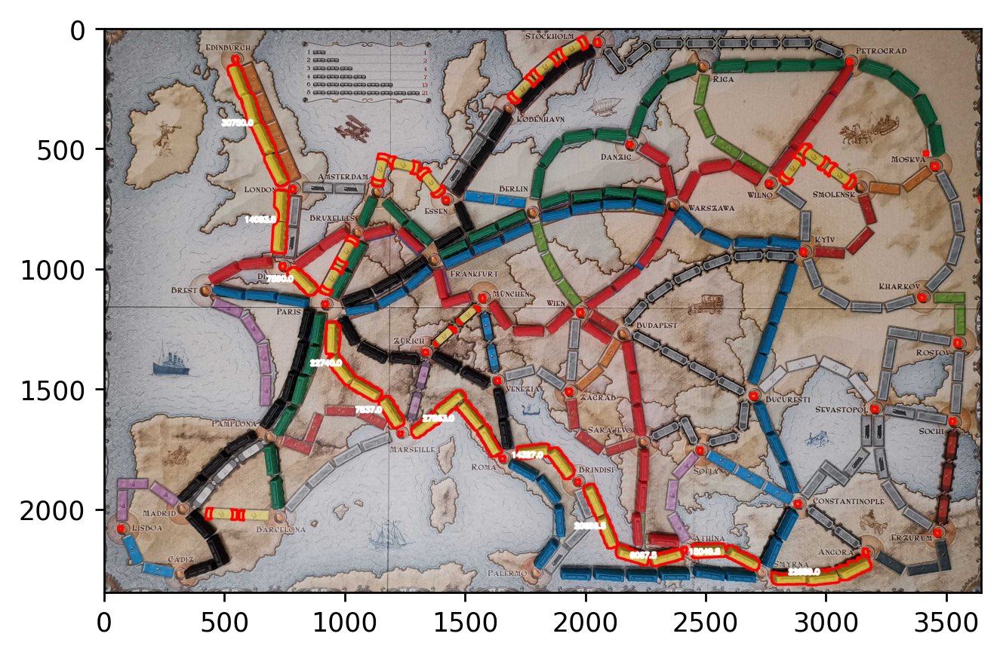

In [75]:
for i in range(len(contours)):
    area = cv2.contourArea(contours[i])
    if area < 6000:
        continue
    string = f'{area}'
    M = cv2.moments(contours[i])
    cX = int((M["m10"] / M["m00"]))
    cY = int((M["m01"] / M["m00"]))
    cv2.putText(img_cnt, string, (cX-150, cY), cv2.FONT_HERSHEY_SIMPLEX, 1, (255, 255, 255), 10)
    
plt.figure(dpi=250)    
plt.imshow(img_cnt)

### BLACK

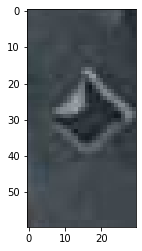

In [291]:
plt.imshow(img_cv[1750:1810, 1770:1800])

In [292]:
np.unique(HUE[1750:1810, 1770:1800])

array([ 1,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19,
       20, 21, 22, 23, 24, 25, 26, 27], dtype=uint8)

In [293]:
np.unique(LIGHT[1750:1810, 1770:1800])

array([ 84,  86,  88,  90,  91,  92,  93,  94,  96,  98,  99, 100, 101,
       102, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115,
       116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128,
       129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141,
       142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154,
       155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167,
       168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180,
       181, 182, 183, 184, 185, 186, 187, 189, 190], dtype=uint8)

In [294]:
np.unique(SAT[1750:1810, 1770:1800])

array([ 30,  32,  33,  35,  36,  37,  38,  39,  40,  41,  42,  43,  44,
        45,  46,  47,  48,  49,  50,  51,  52,  53,  54,  55,  56,  57,
        58,  59,  60,  61,  62,  63,  64,  65,  66,  67,  68,  69,  70,
        72,  73,  74,  76,  79,  80,  81,  82,  83,  84,  85,  86,  87,
        88,  91,  96,  99, 100, 101, 104, 105, 106, 108, 109, 110, 111,
       112, 113, 114, 116, 117, 118, 119, 120, 121, 123, 124, 126, 127,
       128, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141,
       142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154,
       155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167,
       168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180,
       181, 183, 186, 191], dtype=uint8)

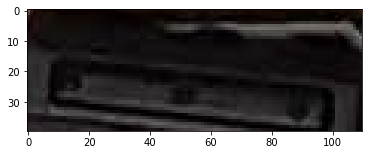

In [302]:
plot_img(img_cv[1450:1490,1290:1400], figsize=(6,3))

In [112]:
np.unique(HUE[1450:1490,1290:1400])

array([ 1,  3,  5,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 19],
      dtype=uint8)

In [113]:
np.unique(LIGHT[1450:1490,1290:1400])

array([ 22,  24,  26,  30,  31,  32,  34,  36,  37,  40,  41,  42,  43,
        44,  45,  46,  47,  48,  49,  50,  51,  52,  53,  54,  55,  56,
        57,  58,  59,  60,  61,  62,  63,  64,  65,  66,  67,  68,  70,
        71,  72,  73,  74,  75,  76,  78,  79,  80,  81,  82,  83,  84,
        86,  87,  88,  90,  92,  93,  94,  95,  96,  97,  98,  99, 100,
       101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113,
       114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126,
       127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139,
       140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152,
       153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165,
       166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178,
       179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 192,
       193, 194, 195, 196, 197, 199, 201, 202, 205], dtype=uint8)

In [114]:
np.unique(SAT[1450:1490,1290:1400])

array([ 22,  23,  24,  25,  26,  27,  28,  29,  30,  31,  32,  33,  34,
        35,  36,  37,  38,  39,  40,  41,  42,  43,  44,  45,  46,  47,
        48,  49,  50,  51,  52,  53,  54,  55,  56,  57,  58,  59,  60,
        61,  62,  63,  64,  65,  66,  67,  68,  69,  70,  71,  72,  73,
        74,  75,  76,  77,  78,  79,  80,  81,  82,  83,  84,  85,  87,
        88,  90,  91,  92,  93,  94,  95,  96,  97,  98,  99, 100, 101,
       103, 104, 106, 108, 110, 116, 120, 122, 124, 128, 133, 137, 145,
       155, 160, 178, 193, 209], dtype=uint8)

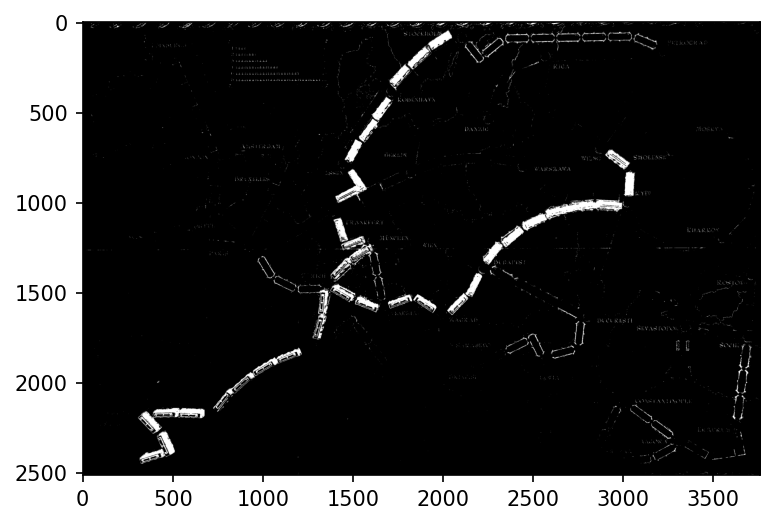

In [54]:
mask = (LIGHT < 30) & (HUE < 180) & (SAT < 210)
img2 = img_cv.copy()
# img2[mask] = 0

plt.figure(dpi=150)  
# plt.axis('off')
plt.imshow(mask, cmap="gray")

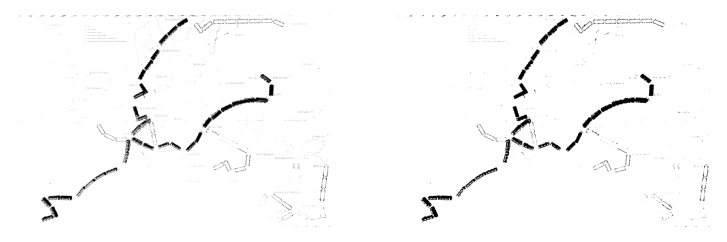

In [55]:
mask_int = mask.astype(np.uint8)
kernel = np.ones((5,5))
mask_int = cv2.morphologyEx(mask_int, cv2.MORPH_CLOSE, kernel)
kernel = np.ones((3,3))
mask_int = cv2.morphologyEx(mask_int, cv2.MORPH_OPEN, kernel)


plt.figure(dpi=150)
plt.subplot(1,2,1)   
plt.axis('off')
plt.imshow(1 - mask, cmap="gray")
plt.subplot(1,2,2)  
plt.axis('off')
plt.imshow(1 - mask_int, cmap="gray")

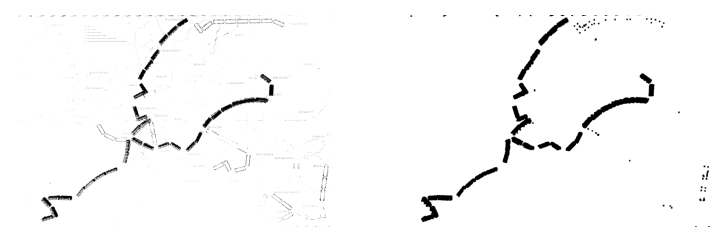

In [56]:
mask_int = mask.astype(np.uint8)
kernel = np.ones((5,5))
mask_int = cv2.morphologyEx(mask_int, cv2.MORPH_DILATE, kernel)
kernel = np.ones((11,11))
mask_int = cv2.morphologyEx(mask_int, cv2.MORPH_ERODE, kernel)
kernel = np.ones((17,17))
mask_int = cv2.morphologyEx(mask_int, cv2.MORPH_DILATE, kernel)


plt.figure(dpi=150)
plt.subplot(1,2,1)   
plt.axis('off')
plt.imshow(1 - mask, cmap="gray")
plt.subplot(1,2,2)  
plt.axis('off')
plt.imshow(1 - mask_int, cmap="gray")

In [57]:
contours, hierarchy = cv2.findContours(mask_int, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)

img_cnt = res.copy()
cv2.drawContours(img_cnt, contours, -1, (255,0,0), 10);

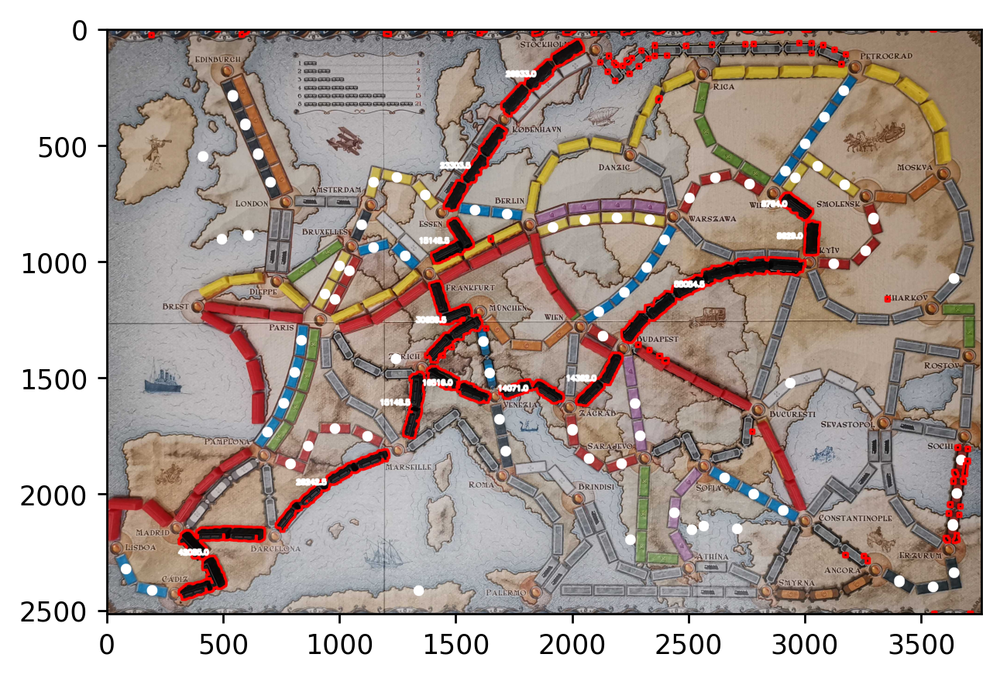

In [58]:
for i in range(len(contours)):
    area = cv2.contourArea(contours[i])
    if area < 6000:
        continue
    string = f'{area}'
    M = cv2.moments(contours[i])
    cX = int((M["m10"] / M["m00"]))
    cY = int((M["m01"] / M["m00"]))
    cv2.putText(img_cnt, string, (cX-150, cY), cv2.FONT_HERSHEY_SIMPLEX, 1, (255, 255, 255), 10)
    
plt.figure(dpi=250)    
plt.imshow(img_cnt)